In [1]:
import stlearn as st
from pathlib import Path
st.settings.set_figure_params(dpi=180)
import pandas as pd
import math
import scipy as sp
import numpy as np
import matplotlib.pyplot as plt
import scanpy as sc
import seaborn as sns
import harmonypy as hm

# Load Data for analysis

In [2]:
#Inports datasets 

data = st.Read10X("I:/SPOPSCC-Q4358/Visium_FFPE_Jaz_2/D1_PA21P7147_S01/")
new_data = st.Read10X("I:/SPOPSCC-Q4358/Visium_FFPE_54_newS01/A1_VLP54_S01_new/outs/")
P5 = st.Read10X("I:/SPOPSCC-Q4358/Visium_FFPE_Jaz_2/D2_PA20P38457_PA20P42157/")

C:\Users\s4435234\Anaconda3\lib\site-packages\anndata\_core\anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
C:\Users\s4435234\Anaconda3\lib\site-packages\anndata\_core\anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
C:\Users\s4435234\Anaconda3\lib\site-packages\anndata\_core\anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [3]:
#Adds specific tissue type annotations to Anndata object (tissue rep 1 and tissue rep 2)
tissue_lab_file = pd.read_csv("I:/SPOPSCC-Q4358/Visium_FFPE_Jaz_2/Andrew_loupe/D1_149_whole.csv", dtype={'D1_149':'Int32'})
tissue_lab_file.index = tissue_lab_file['Barcode']
tissue_lab_file = tissue_lab_file.drop(columns="Barcode")
tissue_lab_file['D1_149'] = tissue_lab_file['D1_149'].astype(str)
data.obs['tissue_type'] = tissue_lab_file['D1_149'].astype('category')

In [4]:
#Adds specific tissue type annotations to Anndata object (tissue rep 1 and tissue rep 2)
tissue_lab_file_p5 = pd.read_csv("I:/SPOPSCC-Q4358/Visium_FFPE_Jaz_2/Andrew_loupe/D2_157.csv", dtype={'D2_157':'Int32'})
tissue_lab_file_p5.index = tissue_lab_file_p5['Barcode']
tissue_lab_file_p5 = tissue_lab_file_p5.drop(columns="Barcode")
tissue_lab_file_p5['D2_157'] = tissue_lab_file_p5['PA20P42157_1J '].astype(str)
P5.obs['tissue_type'] = tissue_lab_file_p5['D2_157'].astype('category')

In [5]:
P5.obs

,in_tissue,array_row,array_col,imagecol,imagerow,tissue_type
AAACAAGTATCTCCCA-1,1,50,102,1474.025978,1256.070020,1.0
AAACACCAATAACTGC-1,1,59,19,412.761153,1460.191986,1.0
AAACAGAGCGACTCCT-1,1,14,94,1369.000568,454.827782,nan
AAACAGCTTTCAGAAG-1,1,43,9,283.455675,1104.178433,1.0
AAACAGGGTCTATATT-1,1,47,13,335.121401,1193.111240,1.0
...,...,...,...,...,...,...
TTGTTGGCAATGACTG-1,1,76,30,554.771317,1837.944669,1.0
TTGTTTCACATCCAGG-1,1,58,42,706.945230,1436.758897,1.0
TTGTTTCATTAGTCTA-1,1,60,30,553.642012,1481.931116,1.0
TTGTTTCCATACAACT-1,1,45,27,514.116320,1147.939020,1.0


C:\Users\s4435234\Anaconda3\lib\site-packages\anndata\compat\_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


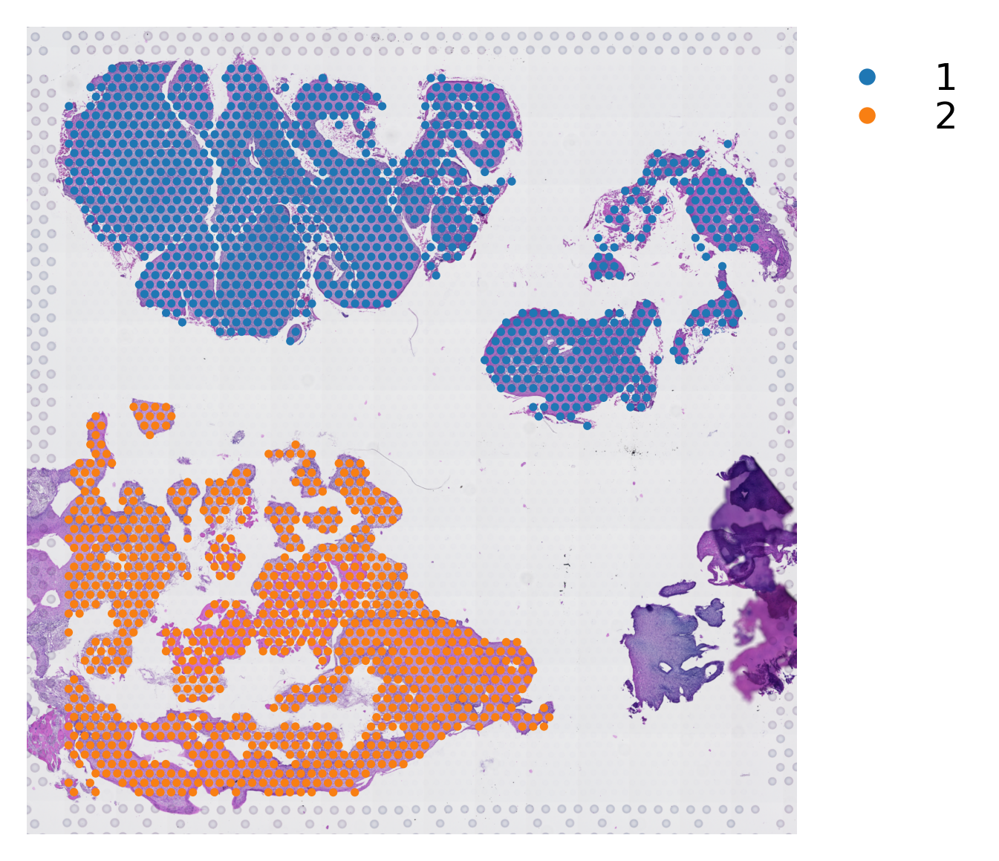

In [6]:
#adds and plots sample infomation
batch = []
for i in data.obs['tissue_type']:
    if i == "3":
        x = "2"
    elif i == "<NA>":
        x = "<NA>"
    else:
        x = "1"
    batch.append(x)
    
data.obs['batch'] = batch
data.obs['batch'] = data.obs['batch'].astype('category')
data = data[data.obs.batch != "<NA>", :]
st.pl.cluster_plot(data, use_label='batch')

C:\Users\s4435234\Anaconda3\lib\site-packages\anndata\compat\_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


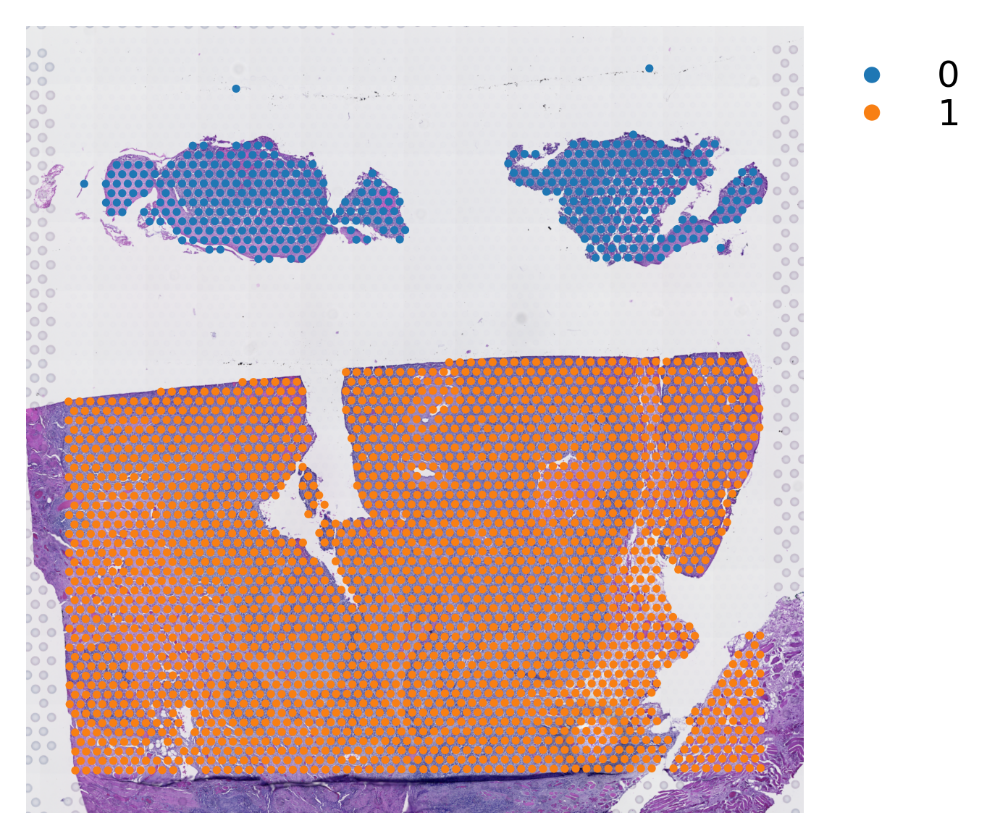

In [7]:
#adds and plots sample infomation
batch = []
for i in P5.obs['tissue_type']:
    if i == "nan":
        x = "0"
    else:
        x = "1"
    batch.append(x)
    
P5.obs['batch'] = batch
P5.obs['batch'] = P5.obs['batch'].astype('category')
P5 = P5[P5.obs.batch != "<NA>", :]
st.pl.cluster_plot(P5, use_label='batch')

# Data pre-processing and subseting

In [9]:
#subsets Anndata to generate tumour and healthy datasets
old_tumour = data[data.obs["batch"] == "1"]
healthy = data[data.obs["batch"] == "2"]
p5 = P5[P5.obs["batch"] == "1"]

#filters and normalises each dataset
st.pp.filter_genes(data,min_cells=3)
st.pp.filter_genes(new_data,min_cells=3)
st.pp.filter_genes(old_tumour,min_cells=3)
st.pp.filter_genes(healthy,min_cells=3)
st.pp.filter_genes(p5,min_cells=3)

#normalise each dataset
st.pp.normalize_total(data)
st.pp.normalize_total(new_data)
st.pp.normalize_total(old_tumour)
st.pp.normalize_total(healthy)
st.pp.normalize_total(p5)

data_adj = data.copy()
old_tumour_adj = old_tumour.copy()
new_data_adj = new_data.copy()
healthy_adj = healthy.copy()
p5_adj = p5.copy()

Normalization step is finished in adata.X
Normalization step is finished in adata.X
Normalization step is finished in adata.X
Normalization step is finished in adata.X
Normalization step is finished in adata.X


# Subset L-R pair database for only previously identified druggable targets

In [10]:
#loads LR pair database
lrs = st.tl.cci.load_lrs(['connectomeDB2020_lit'], species='human')


In [102]:
#lists of LR pairs targeted
drug_list = ["NDRG1", "SOX4","GAS1","POLR1D","SNAI2","NXPH4","IL33","PLOD2","RUVBL1","ALCAM"]
target_list = ["VEGFA","TF","TFRC","CA9","PGF","MCM7","EGFR","PDCD1","CD274","EGLN3","GMPS","PTGFRN","ITGA2","OPA1","NSD2","MLF1","CA12"]

In [103]:
#Subsets LR pair database to only have pairs which match to gene lists identified above
LR_drug_match = []
LR_target_match = []
for i in list(lrs):
    lr_string = str(i)
    split = lr_string.split("_")
    if split[0] in drug_list or split[1] in drug_list:
        LR_drug_match.append(i)
    if split[0] in target_list or split[1] in target_list:
        LR_target_match.append(i)
LR_drugs = np.array(LR_drug_match, dtype='<U18')
LR_drugs

array(['ALCAM_CD6', 'ALCAM_CHL1', 'ALCAM_L1CAM', 'ALCAM_NRP1',
       'CD6_ALCAM', 'IL33_IL1RL1', 'L1CAM_ALCAM', 'SHH_GAS1'],
      dtype='<U18')

In [104]:
LR_targets = np.array(LR_target_match, dtype='<U18')
LR_targets

array(['AMH_EGFR', 'ANXA1_EGFR', 'AREG_EGFR', 'BTC_EGFR', 'CD274_CD80',
       'CD274_PDCD1', 'CD80_CD274', 'CDH1_EGFR', 'CHAD_ITGA2',
       'COL1A1_ITGA2', 'COL1A2_ITGA2', 'COL2A1_ITGA2', 'COL8A1_ITGA2',
       'DCN_EGFR', 'EFEMP1_EGFR', 'EGF_EGFR', 'EPGN_EGFR', 'EREG_EGFR',
       'FGL1_EGFR', 'FN1_ITGA2', 'GNAI2_EGFR', 'HBEGF_EGFR',
       'HSP90AA1_EGFR', 'HSPG2_ITGA2', 'L1CAM_EGFR', 'LAMA1_ITGA2',
       'MMP1_ITGA2', 'PDCD1LG2_PDCD1', 'PGF_FLT1', 'PGF_NRP1', 'PGF_NRP2',
       'SPINK1_EGFR', 'TF_TFR2', 'TF_TFRC', 'TGFA_EGFR', 'TNC_EGFR',
       'VCAN_EGFR', 'VEGFA_FLT1', 'VEGFA_GPC1', 'VEGFA_KDR', 'VEGFA_NRP1',
       'VEGFA_NRP2', 'ZP3_EGFR'], dtype='<U18')

# Run L-R analysis with whole database

In [11]:
######## RUN WHOLE L-R DATABASE L-R ANLYSIS
lrs = st.tl.cci.load_lrs(['connectomeDB2020_lit'], species='human')

st.tl.cci.run(data, lrs,
                  min_spots = 20, #Filter out any LR pairs with no scores for less than min_spots
                  distance=None, # None defaults to spot+immediate neighbours; distance=0 for within-spot mode
                  n_pairs=10000, # Number of random pairs to generate; low as example, recommend ~10,000
                  n_cpus=4, # Number of CPUs for parallel. If None, detects & use all available.
                  )

st.tl.cci.run(new_data, lrs,
                  min_spots = 0, #Filter out any LR pairs with no scores for less than min_spots
                  distance=None, # None defaults to spot+immediate neighbours; distance=0 for within-spot mode
                  n_pairs=10000, # Number of random pairs to generate; low as example, recommend ~10,000
                  n_cpus=4, # Number of CPUs for parallel. If None, detects & use all available.
                  )

st.tl.cci.run(old_tumour, lrs,
                  min_spots = 20, #Filter out any LR pairs with no scores for less than min_spots
                  distance=None, # None defaults to spot+immediate neighbours; distance=0 for within-spot mode
                  n_pairs=10000, # Number of random pairs to generate; low as example, recommend ~10,000
                  n_cpus=4, # Number of CPUs for parallel. If None, detects & use all available.
                  )

st.tl.cci.run(healthy, lrs,
                  min_spots = 20, #Filter out any LR pairs with no scores for less than min_spots
                  distance=None, # None defaults to spot+immediate neighbours; distance=0 for within-spot mode
                  n_pairs=10000, # Number of random pairs to generate; low as example, recommend ~10,000
                  n_cpus=4, # Number of CPUs for parallel. If None, detects & use all available.
                  )

Calculating neighbours...
0 spots with no neighbours, 1 median spot neighbours.
Spot neighbour indices stored in adata.obsm['spot_neighbours'] & adata.obsm['spot_neigh_bcs'].
Altogether 904 valid L-R pairs


Generating backgrounds & testing each LR pair...: 100%|███████████████████████████████████████████ [ time left: 00:00 ]



Storing results:

lr_scores stored in adata.obsm['lr_scores'].
p_vals stored in adata.obsm['p_vals'].
p_adjs stored in adata.obsm['p_adjs'].
-log10(p_adjs) stored in adata.obsm['-log10(p_adjs)'].
lr_sig_scores stored in adata.obsm['lr_sig_scores'].

Per-spot results in adata.obsm have columns in same order as rows in adata.uns['lr_summary'].
Summary of LR results in adata.uns['lr_summary'].
Calculating neighbours...
0 spots with no neighbours, 1 median spot neighbours.
Spot neighbour indices stored in adata.obsm['spot_neighbours'] & adata.obsm['spot_neigh_bcs'].
Altogether 792 valid L-R pairs


Generating backgrounds & testing each LR pair...: 100%|███████████████████████████████████████████ [ time left: 00:00 ]



Storing results:

lr_scores stored in adata.obsm['lr_scores'].
p_vals stored in adata.obsm['p_vals'].
p_adjs stored in adata.obsm['p_adjs'].
-log10(p_adjs) stored in adata.obsm['-log10(p_adjs)'].
lr_sig_scores stored in adata.obsm['lr_sig_scores'].

Per-spot results in adata.obsm have columns in same order as rows in adata.uns['lr_summary'].
Summary of LR results in adata.uns['lr_summary'].
Calculating neighbours...
0 spots with no neighbours, 1 median spot neighbours.
Spot neighbour indices stored in adata.obsm['spot_neighbours'] & adata.obsm['spot_neigh_bcs'].
Altogether 704 valid L-R pairs


Generating backgrounds & testing each LR pair...: 100%|███████████████████████████████████████████ [ time left: 00:00 ]



Storing results:

lr_scores stored in adata.obsm['lr_scores'].
p_vals stored in adata.obsm['p_vals'].
p_adjs stored in adata.obsm['p_adjs'].
-log10(p_adjs) stored in adata.obsm['-log10(p_adjs)'].
lr_sig_scores stored in adata.obsm['lr_sig_scores'].

Per-spot results in adata.obsm have columns in same order as rows in adata.uns['lr_summary'].
Summary of LR results in adata.uns['lr_summary'].
Calculating neighbours...
0 spots with no neighbours, 1 median spot neighbours.
Spot neighbour indices stored in adata.obsm['spot_neighbours'] & adata.obsm['spot_neigh_bcs'].
Altogether 707 valid L-R pairs


Generating backgrounds & testing each LR pair...: 100%|███████████████████████████████████████████ [ time left: 00:00 ]


Storing results:

lr_scores stored in adata.obsm['lr_scores'].
p_vals stored in adata.obsm['p_vals'].
p_adjs stored in adata.obsm['p_adjs'].
-log10(p_adjs) stored in adata.obsm['-log10(p_adjs)'].
lr_sig_scores stored in adata.obsm['lr_sig_scores'].

Per-spot results in adata.obsm have columns in same order as rows in adata.uns['lr_summary'].
Summary of LR results in adata.uns['lr_summary'].


In [ ]:
#runs statistical significance analysis to identifiy significant spots
#### Whole dataset
st.tl.cci.adj_pvals(data, correct_axis='spot',
                   pval_adj_cutoff=0.05, adj_method='fdr_bh')
st.tl.cci.adj_pvals(old_tumour, correct_axis='spot',
                   pval_adj_cutoff=0.05, adj_method='fdr_bh')
st.tl.cci.adj_pvals(healthy, correct_axis='spot',
                   pval_adj_cutoff=0.05, adj_method='fdr_bh')
st.tl.cci.adj_pvals(new_data, correct_axis='spot',
                   pval_adj_cutoff=0.05, adj_method='fdr_bh')

In [ ]:
#Plots top 60 LR pairs for each sample for whole dataset analysis
st.pl.lr_summary(data, n_top=60, figsize=(10,3))
st.pl.lr_summary(old_tumour, n_top=60, figsize=(10,3))
st.pl.lr_summary(new_data, n_top=60, figsize=(10,3))
st.pl.lr_summary(healthy, n_top=60, figsize=(10,3))

# Run L-R analysis with druggable targets database subset

In [ ]:
# Runs LR pair analysis in each dataset BETWEEN spots
st.tl.cci.run(data_adj, LR_targets,
                  min_spots = 20, #Filter out any LR pairs with no scores for less than min_spots
                  distance=None, # None defaults to spot+immediate neighbours; distance=0 for within-spot mode
                  n_pairs=10000, # Number of random pairs to generate; low as example, recommend ~10,000
                  n_cpus=4, # Number of CPUs for parallel. If None, detects & use all available.
                  )

st.tl.cci.run(new_data_adj, LR_targets,
                  min_spots = 0, #Filter out any LR pairs with no scores for less than min_spots
                  distance=None, # None defaults to spot+immediate neighbours; distance=0 for within-spot mode
                  n_pairs=10000, # Number of random pairs to generate; low as example, recommend ~10,000
                  n_cpus=4, # Number of CPUs for parallel. If None, detects & use all available.
                  )

st.tl.cci.run(old_tumour_adj, LR_targets,
                  min_spots = 20, #Filter out any LR pairs with no scores for less than min_spots
                  distance=None, # None defaults to spot+immediate neighbours; distance=0 for within-spot mode
                  n_pairs=10000, # Number of random pairs to generate; low as example, recommend ~10,000
                  n_cpus=4, # Number of CPUs for parallel. If None, detects & use all available.
                  )

st.tl.cci.run(healthy_adj, LR_targets,
                  min_spots = 20, #Filter out any LR pairs with no scores for less than min_spots
                  distance=None, # None defaults to spot+immediate neighbours; distance=0 for within-spot mode
                  n_pairs=10000, # Number of random pairs to generate; low as example, recommend ~10,000
                  n_cpus=4, # Number of CPUs for parallel. If None, detects & use all available.
                  )

st.tl.cci.run(p5_adj, LR_targets,
                  min_spots = 20, #Filter out any LR pairs with no scores for less than min_spots
                  distance=None, # None defaults to spot+immediate neighbours; distance=0 for within-spot mode
                  n_pairs=10000, # Number of random pairs to generate; low as example, recommend ~10,000
                  n_cpus=4, # Number of CPUs for parallel. If None, detects & use all available.
                  )

Calculating neighbours...
8 spots with no neighbours, 5 median spot neighbours.
Spot neighbour indices stored in adata.obsm['spot_neighbours'] & adata.obsm['spot_neigh_bcs'].
Altogether 37 valid L-R pairs


Generating backgrounds & testing each LR pair...: 100%|██████████ [ time left: 00:00 ]



Storing results:

lr_scores stored in adata.obsm['lr_scores'].
p_vals stored in adata.obsm['p_vals'].
p_adjs stored in adata.obsm['p_adjs'].
-log10(p_adjs) stored in adata.obsm['-log10(p_adjs)'].
lr_sig_scores stored in adata.obsm['lr_sig_scores'].

Per-spot results in adata.obsm have columns in same order as rows in adata.uns['lr_summary'].
Summary of LR results in adata.uns['lr_summary'].
Calculating neighbours...
4 spots with no neighbours, 6 median spot neighbours.
Spot neighbour indices stored in adata.obsm['spot_neighbours'] & adata.obsm['spot_neigh_bcs'].
Altogether 31 valid L-R pairs


Generating backgrounds & testing each LR pair...: 100%|██████████ [ time left: 00:00 ]



Storing results:

lr_scores stored in adata.obsm['lr_scores'].
p_vals stored in adata.obsm['p_vals'].
p_adjs stored in adata.obsm['p_adjs'].
-log10(p_adjs) stored in adata.obsm['-log10(p_adjs)'].
lr_sig_scores stored in adata.obsm['lr_sig_scores'].

Per-spot results in adata.obsm have columns in same order as rows in adata.uns['lr_summary'].
Summary of LR results in adata.uns['lr_summary'].
Calculating neighbours...
6 spots with no neighbours, 6 median spot neighbours.
Spot neighbour indices stored in adata.obsm['spot_neighbours'] & adata.obsm['spot_neigh_bcs'].
Altogether 36 valid L-R pairs


Generating backgrounds & testing each LR pair...: 100%|██████████ [ time left: 00:00 ]



Storing results:

lr_scores stored in adata.obsm['lr_scores'].
p_vals stored in adata.obsm['p_vals'].
p_adjs stored in adata.obsm['p_adjs'].
-log10(p_adjs) stored in adata.obsm['-log10(p_adjs)'].
lr_sig_scores stored in adata.obsm['lr_sig_scores'].

Per-spot results in adata.obsm have columns in same order as rows in adata.uns['lr_summary'].
Summary of LR results in adata.uns['lr_summary'].
Calculating neighbours...
2 spots with no neighbours, 5 median spot neighbours.
Spot neighbour indices stored in adata.obsm['spot_neighbours'] & adata.obsm['spot_neigh_bcs'].
Altogether 34 valid L-R pairs


Generating backgrounds & testing each LR pair...: 100%|██████████ [ time left: 00:00 ]



Storing results:

lr_scores stored in adata.obsm['lr_scores'].
p_vals stored in adata.obsm['p_vals'].
p_adjs stored in adata.obsm['p_adjs'].
-log10(p_adjs) stored in adata.obsm['-log10(p_adjs)'].
lr_sig_scores stored in adata.obsm['lr_sig_scores'].

Per-spot results in adata.obsm have columns in same order as rows in adata.uns['lr_summary'].
Summary of LR results in adata.uns['lr_summary'].
Calculating neighbours...
0 spots with no neighbours, 6 median spot neighbours.
Spot neighbour indices stored in adata.obsm['spot_neighbours'] & adata.obsm['spot_neigh_bcs'].
Altogether 39 valid L-R pairs


Generating backgrounds & testing each LR pair...: 100%|██████████ [ time left: 00:00 ]


Storing results:

lr_scores stored in adata.obsm['lr_scores'].
p_vals stored in adata.obsm['p_vals'].
p_adjs stored in adata.obsm['p_adjs'].
-log10(p_adjs) stored in adata.obsm['-log10(p_adjs)'].
lr_sig_scores stored in adata.obsm['lr_sig_scores'].

Per-spot results in adata.obsm have columns in same order as rows in adata.uns['lr_summary'].
Summary of LR results in adata.uns['lr_summary'].


In [106]:
st.tl.cci.adj_pvals(data_adj, correct_axis='spot',
                   pval_adj_cutoff=0.05, adj_method='fdr_bh')
st.tl.cci.adj_pvals(old_tumour_adj, correct_axis='spot',
                   pval_adj_cutoff=0.05, adj_method='fdr_bh')
st.tl.cci.adj_pvals(healthy_adj, correct_axis='spot',
                   pval_adj_cutoff=0.05, adj_method='fdr_bh')
st.tl.cci.adj_pvals(new_data_adj, correct_axis='spot',
                   pval_adj_cutoff=0.05, adj_method='fdr_bh')
st.tl.cci.adj_pvals(p5_adj, correct_axis='spot',
                   pval_adj_cutoff=0.05, adj_method='fdr_bh')

Updated adata.uns[lr_summary]
Updated adata.obsm[lr_scores]
Updated adata.obsm[lr_sig_scores]
Updated adata.obsm[p_vals]
Updated adata.obsm[p_adjs]
Updated adata.obsm[-log10(p_adjs)]
Updated adata.uns[lr_summary]
Updated adata.obsm[lr_scores]
Updated adata.obsm[lr_sig_scores]
Updated adata.obsm[p_vals]
Updated adata.obsm[p_adjs]
Updated adata.obsm[-log10(p_adjs)]
Updated adata.uns[lr_summary]
Updated adata.obsm[lr_scores]
Updated adata.obsm[lr_sig_scores]
Updated adata.obsm[p_vals]
Updated adata.obsm[p_adjs]
Updated adata.obsm[-log10(p_adjs)]
Updated adata.uns[lr_summary]
Updated adata.obsm[lr_scores]
Updated adata.obsm[lr_sig_scores]
Updated adata.obsm[p_vals]
Updated adata.obsm[p_adjs]
Updated adata.obsm[-log10(p_adjs)]
Updated adata.uns[lr_summary]
Updated adata.obsm[lr_scores]
Updated adata.obsm[lr_sig_scores]
Updated adata.obsm[p_vals]
Updated adata.obsm[p_adjs]
Updated adata.obsm[-log10(p_adjs)]


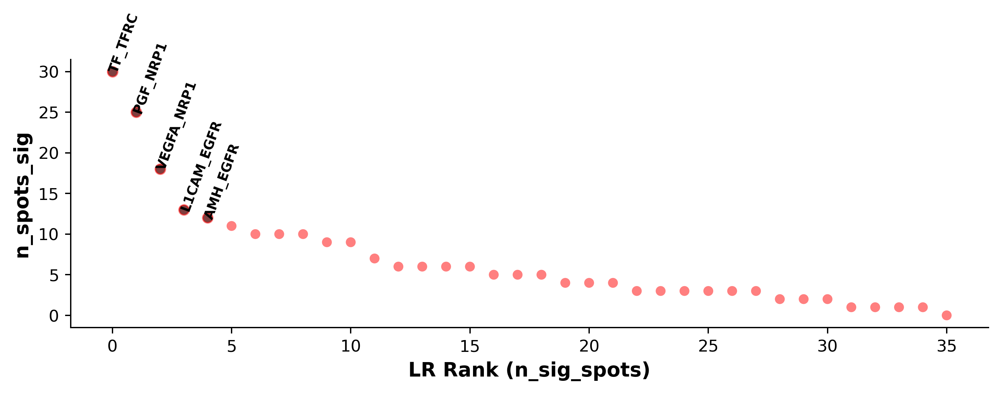

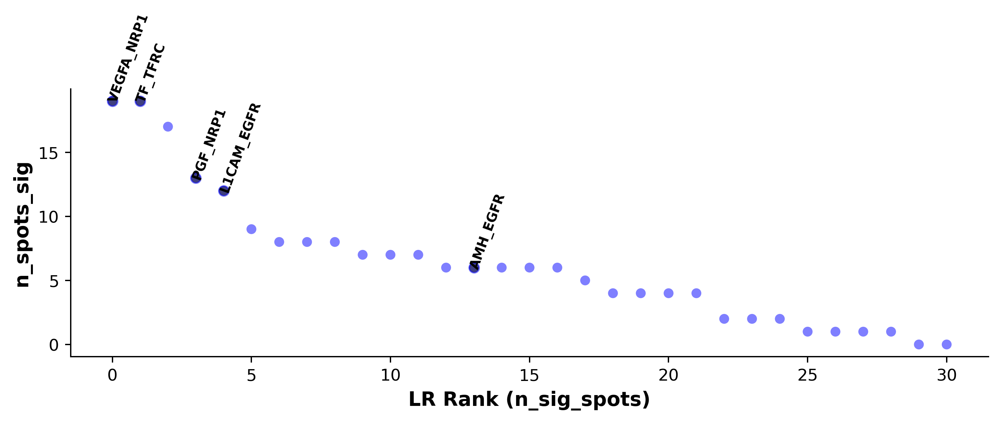

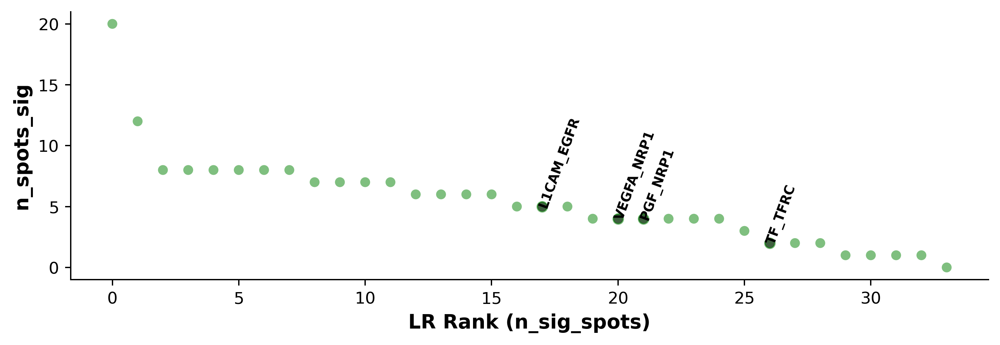

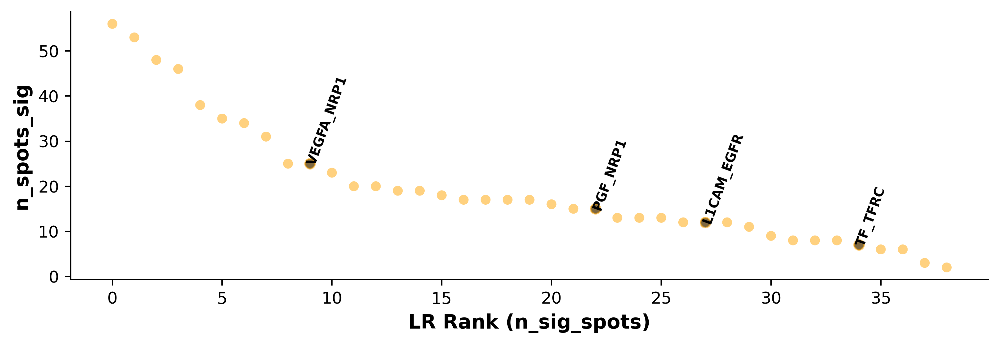

In [107]:
#st.pl.lr_summary(data_adj, n_top=60, figsize=(10,3))
categories=['TF_TFRC', 'PGF_NRP1', 'VEGFA_NRP1', 'L1CAM_EGFR','AMH_EGFR']
categories_healthy=['TF_TFRC', 'PGF_NRP1', 'VEGFA_NRP1', 'L1CAM_EGFR']
st.pl.lr_summary(old_tumour_adj, color="red",  n_top=60, highlight_lrs = categories, highlight_color="black", figsize=(10,3))
st.pl.lr_summary(new_data_adj, color = "blue", n_top=60, highlight_lrs = categories,highlight_color="black",figsize=(10,3))
st.pl.lr_summary(healthy_adj, n_top=60, color = "green", highlight_lrs = categories_healthy,highlight_color="black",figsize=(10,3))
st.pl.lr_summary(p5_adj, n_top=60, color = "orange", highlight_lrs = categories_healthy,highlight_color="black",figsize=(10,3))

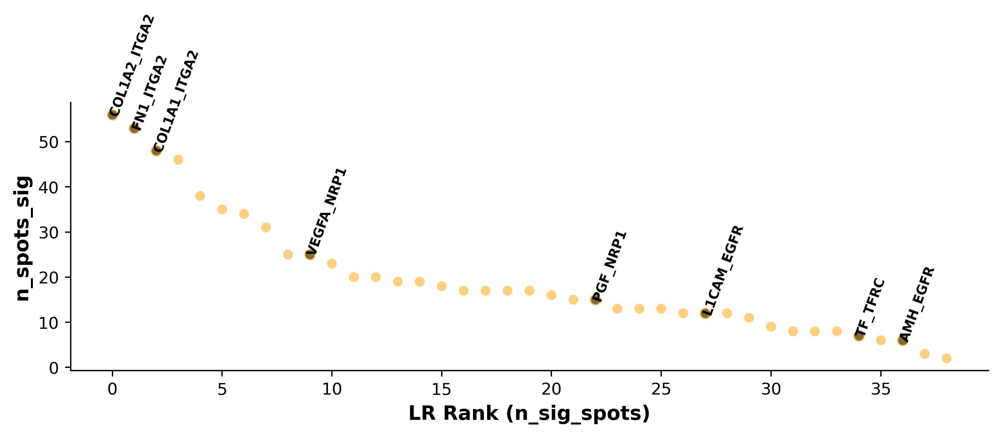

In [113]:
categories=['TF_TFRC', 'PGF_NRP1', 'VEGFA_NRP1', 'L1CAM_EGFR','AMH_EGFR','COL1A2_ITGA2','COL1A1_ITGA2','FN1_ITGA2']

st.pl.lr_summary(p5_adj, n_top=60, color = "orange", highlight_lrs = categories,highlight_color="black",figsize=(10,3))

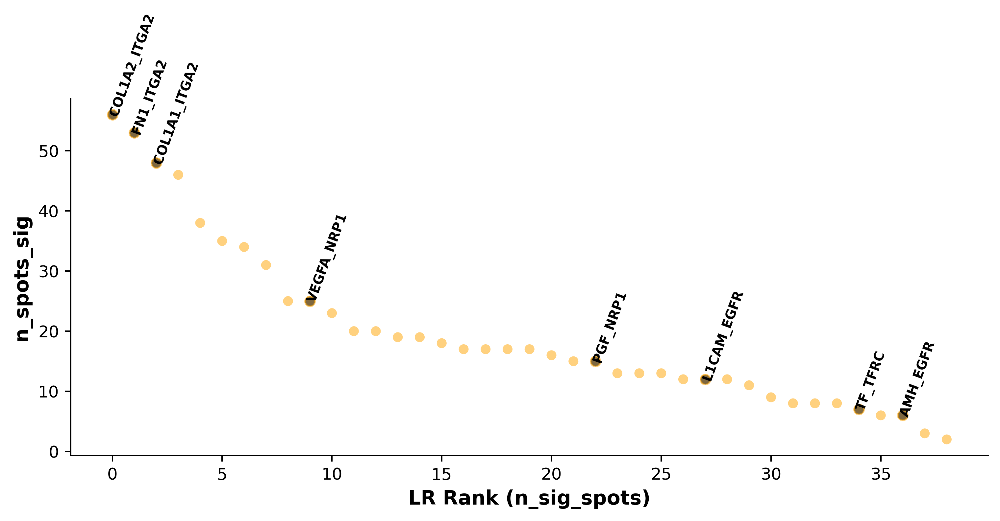

In [131]:
fig, ax = plt.subplots(figsize=(10,4))

st.pl.lr_summary(p5_adj, n_top=60, ax=ax, color = "orange", highlight_lrs = categories,highlight_color="black",figsize=(10,3))
#fig.savefig("I:/SPOPSCC-Q4358/stlearn/scatter_p5.pdf")

In [132]:
#fig, ax = plt.subplots(figsize=(10,4))
st.pl.lr_summary(new_data_adj, ax = ax, color = "blue", n_top=60, highlight_lrs = categories,highlight_color="black",figsize=(10,3))
#fig.savefig("I:/SPOPSCC-Q4358/stlearn/scatter_new.pdf")

In [133]:
#categories_healthy_p5=['TF_TFRC', 'PGF_NRP1', 'VEGFA_NRP1', 'L1CAM_EGFR','COL1A2_ITGA2','COL1A1_ITGA2','FN1_ITGA2']

#fig, ax = plt.subplots(figsize=(10,4))
st.pl.lr_summary(healthy_adj, n_top=60, ax=ax, color = "green", highlight_lrs = categories_healthy_p5,highlight_color="black",figsize=(10,3))
#fig.savefig("I:/SPOPSCC-Q4358/stlearn/scatter_healthy.pdf")




In [134]:
#fig, ax = plt.subplots(figsize=(10,4))
st.pl.lr_summary(old_tumour_adj, color="red", ax=ax, n_top=60, highlight_lrs = categories, highlight_color="black", figsize=(10,3))
#fig.savefig("I:/SPOPSCC-Q4358/stlearn/scatter_old.pdf")


In [135]:
fig.savefig("I:/SPOPSCC-Q4358/stlearn/scatter_comb_p5.pdf")

# Compare top hits across MAR21, SEP21 and P5 samples

In [109]:
lrsum = old_tumour_adj.uns["lr_summary"]
lrsum["percent"] = lrsum["n_spots_sig"]*100/old_tumour_adj.n_obs 
old_tumour_adj.uns["lr_summary"] = lrsum

lrsum = healthy_adj.uns["lr_summary"]
lrsum["percent"] = lrsum["n_spots_sig"]*100/healthy_adj.n_obs
healthy_adj.uns["lr_summary"] = lrsum

lrsum = new_data_adj.uns["lr_summary"]
lrsum["percent"] = lrsum["n_spots_sig"]*100/new_data_adj.n_obs
new_data_adj.uns["lr_summary"] = lrsum

df_h = healthy_adj.uns["lr_summary"]
df_h["healthy"] = df_h["n_spots_sig"]
df_h = df_h.transpose()

df_t = old_tumour_adj.uns["lr_summary"]
df_t["old_tumour"] = df_t["n_spots_sig"]
df_t = df_t.transpose()

df_n = new_data_adj.uns["lr_summary"]
df_n["new_tumour"] = df_n["n_spots_sig"]
df_n = df_n.transpose()

df_p5 = p5_adj.uns["lr_summary"]
df_p5["P5_157"] = df_p5["n_spots_sig"]
df_p5 = df_p5.transpose()


df_h = df_h.drop(["n_spots_sig","n_spots_sig_pval","n_spots","percent"])
df_t = df_t.drop(["n_spots_sig","n_spots_sig_pval","n_spots","percent"])
df_n = df_n.drop(["n_spots_sig","n_spots_sig_pval","n_spots","percent"])
df_p5 = df_p5.drop(["n_spots_sig","n_spots_sig_pval","n_spots"])
combined = pd.concat([df_t,df_h,df_n,df_p5], axis=0)
combined = combined.fillna(0)
combined

,TF_TFRC,PGF_NRP1,VEGFA_NRP1,L1CAM_EGFR,AMH_EGFR,VEGFA_GPC1,CD274_CD80,CD80_CD274,VCAN_EGFR,LAMA1_ITGA2,...,EPGN_EGFR,MMP1_ITGA2,PDCD1LG2_PDCD1,FN1_ITGA2,AREG_EGFR,EFEMP1_EGFR,EREG_EGFR,EGF_EGFR,CHAD_ITGA2,SPINK1_EGFR
old_tumour,30.0,25.0,18.0,13.0,12.0,11.0,10.0,10.0,10.0,9.0,...,2.0,2.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0
healthy,2.0,4.0,4.0,5.0,0.0,8.0,7.0,7.0,4.0,0.0,...,20.0,1.0,5.0,7.0,2.0,4.0,8.0,4.0,0.0,0.0
new_tumour,19.0,13.0,19.0,12.0,6.0,9.0,0.0,0.0,6.0,0.0,...,0.0,17.0,1.0,6.0,1.0,4.0,2.0,4.0,0.0,0.0
P5_157,7.0,15.0,25.0,12.0,6.0,46.0,17.0,17.0,13.0,23.0,...,15.0,34.0,16.0,53.0,19.0,17.0,20.0,3.0,12.0,8.0


<AxesSubplot:>

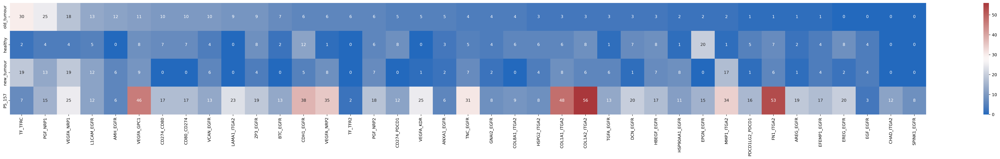

In [110]:
fig, ax = plt.subplots(figsize=(50,5))
sns.heatmap(combined, ax = ax, cmap = "vlag", annot=True)

In [136]:
comb = combined[combined.columns.intersection(categories)]
comb = comb.round(2)

# Generate Spider plot with top5 L-R pair hits specific to MAR21 and SEP21 tumours

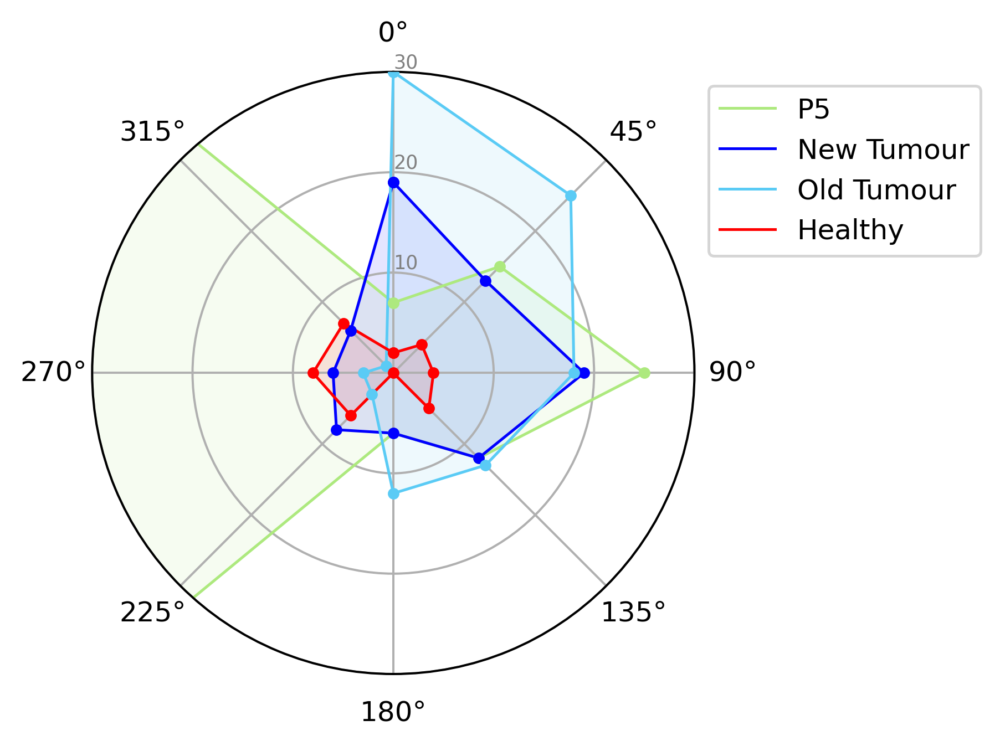

<Figure size 1080x720 with 0 Axes>

In [138]:
from math import pi
#categories=['TF_TFRC', 'PGF_NRP1', 'VEGFA_NRP1', 'TGFB1_VASN', 'VEGFA_GPC1']
N = len(categories)
angles = [n / float(N) * 2 * pi for n in range(N)]
angles += angles[:1]
ax = plt.subplot(111, polar=True)
ax.set_theta_offset(pi / 2)
ax.set_theta_direction(-1)


plt.xticks(angles[:-1])


# Draw ylabels
ax.set_rlabel_position(0)
plt.yticks([10,20,30], ["10","20","30"], color="grey", size=7)
plt.ylim(0,30)

 

# ------- PART 2: Add plots
 
# Plot each individual = each line of the data
# I don't make a loop, because plotting more than 3 groups makes the chart unreadable


# Ind3
values=comb[2:3].values.flatten().tolist()
values += values[:1]
ax.plot(angles, values, linewidth=1, linestyle='solid', label="New Tumour", color = "blue")
ax.fill(angles, values, 'b', alpha=0.1)
ax.scatter(angles,values,s=10, color = "blue",zorder = 10)

# Ind1
values=comb[0:1].values.flatten().tolist()
values += values[:1]
ax.plot(angles, values, linewidth=1, linestyle='solid', label="Old Tumour",color = "#5ACBF5")
ax.fill(angles, values, '#5ACBF5', alpha=0.1)
ax.scatter(angles,values,s=10, color = "#5ACBF5",zorder = 10)
 
# Ind2
values=comb[1:2].values.flatten().tolist()
values += values[:1]
ax.plot(angles, values, linewidth=1, linestyle='solid', label="Healthy", color = "red")
ax.fill(angles, values, 'red', alpha=0.1)
ax.scatter(angles,values,s=10, color = "red",zorder = 10)

 
# Add legend
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))

# Show the graph
plt.show()
plt.savefig("I:/SPOPSCC-Q4358/stlearn/download_n_spots.jpeg")

# View Top L-R pairs on tissue image

<AxesSubplot:>

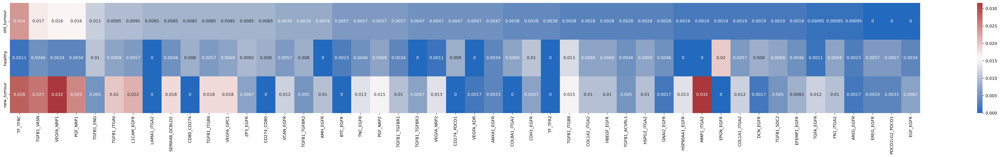

In [36]:
lrsum = old_tumour_adj.uns["lr_summary"]
lrsum["percent"] = lrsum["n_spots_sig"]/old_tumour_adj.n_obs 
old_tumour_adj.uns["lr_summary"] = lrsum

lrsum = healthy_adj.uns["lr_summary"]
lrsum["percent"] = lrsum["n_spots_sig"]/healthy_adj.n_obs
healthy_adj.uns["lr_summary"] = lrsum

lrsum = new_data_adj.uns["lr_summary"]
lrsum["percent"] = lrsum["n_spots_sig"]/new_data_adj.n_obs
new_data_adj.uns["lr_summary"] = lrsum

df_h = healthy_adj.uns["lr_summary"]
df_h["healthy"] = df_h["percent"]
df_h = df_h.transpose()

df_t = old_tumour_adj.uns["lr_summary"]
df_t["old_tumour"] = df_t["percent"]
df_t = df_t.transpose()

df_n = new_data_adj.uns["lr_summary"]
df_n["new_tumour"] = df_n["percent"]
df_n = df_n.transpose()

df_h = df_h.drop(["n_spots_sig","n_spots_sig_pval","n_spots","percent"])
df_t = df_t.drop(["n_spots_sig","n_spots_sig_pval","n_spots","percent"])
df_n = df_n.drop(["n_spots_sig","n_spots_sig_pval","n_spots","percent"])
combined = pd.concat([df_t,df_h,df_n], axis=0)
combined = combined.fillna(0)
combined

fig, ax = plt.subplots(figsize=(50,5))
sns.heatmap(combined, ax = ax, cmap = "vlag", annot=True)

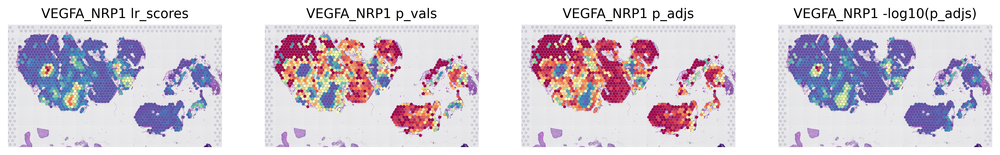

In [37]:
best_lr = old_tumour_adj.uns['lr_summary'].index.values[2]
stats = ['lr_scores', 'p_vals', 'p_adjs', '-log10(p_adjs)']
fig, axes = plt.subplots(ncols=len(stats), figsize=(16,6))
for i, stat in enumerate(stats):
    st.pl.lr_result_plot(old_tumour_adj, use_result=stat, use_lr=best_lr, show_color_bar=False, ax=axes[i])
    axes[i].set_title(f'{best_lr} {stat}')

C:\Users\s4435234\Anaconda3\lib\site-packages\stlearn\plotting\cci_plot.py:764: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[f"{lr}_binary_labels"] = lr_binary_labels


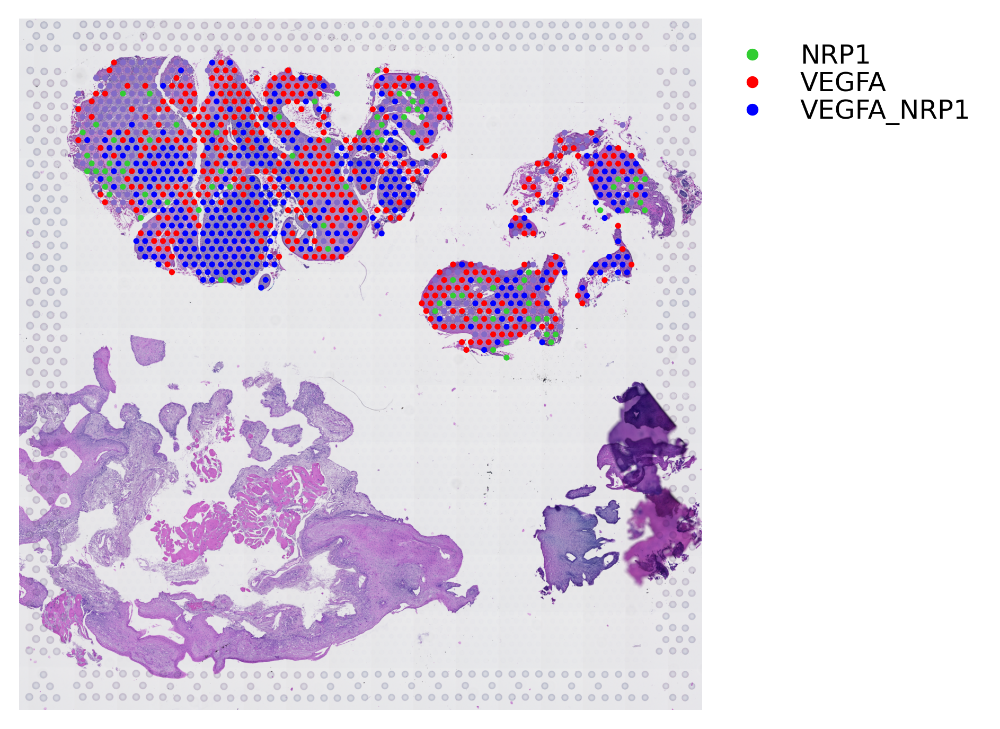

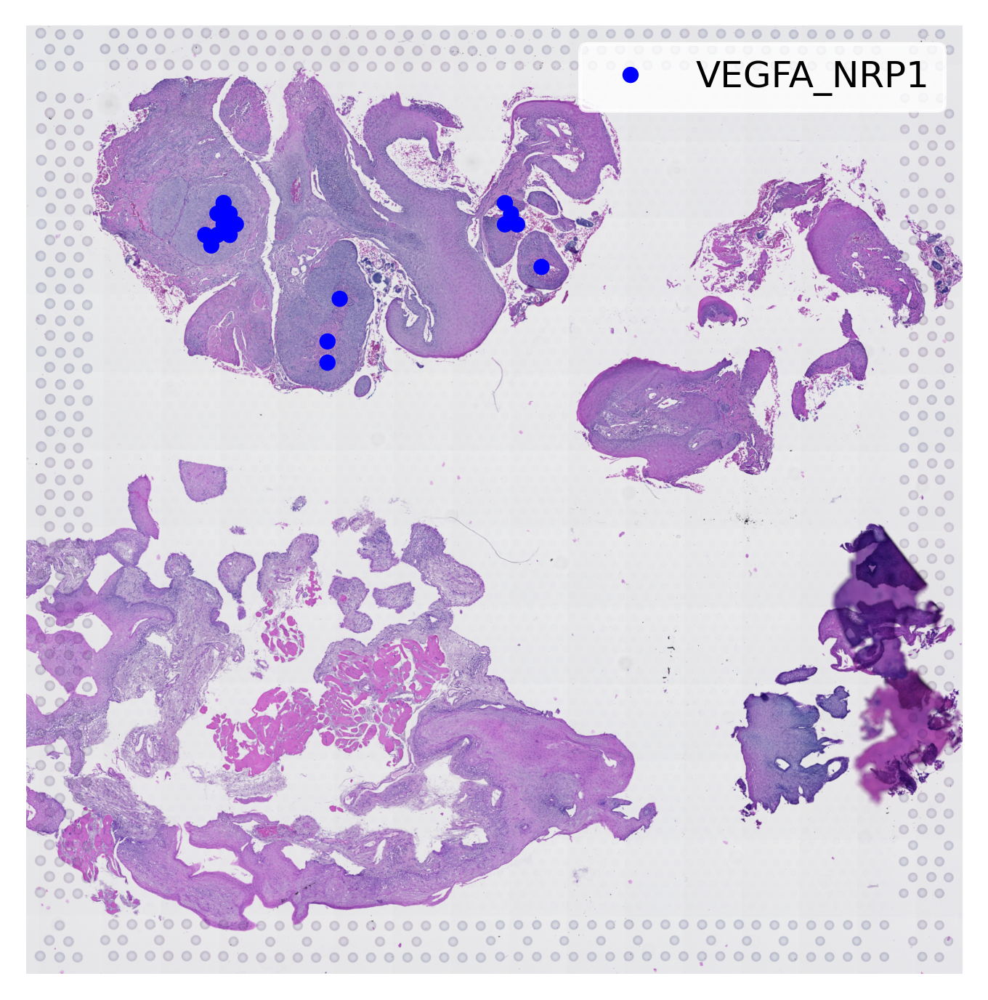

In [38]:
st.pl.lr_plot(old_tumour_adj, best_lr, inner_size_prop=0.1, outer_mode='binary', pt_scale=5,
              use_label=None, show_image=True,
              sig_spots=False)
st.pl.lr_plot(old_tumour_adj, best_lr, outer_size_prop=1, outer_mode='binary', pt_scale=20,
              use_label=None, show_image=True,
              sig_spots=True)

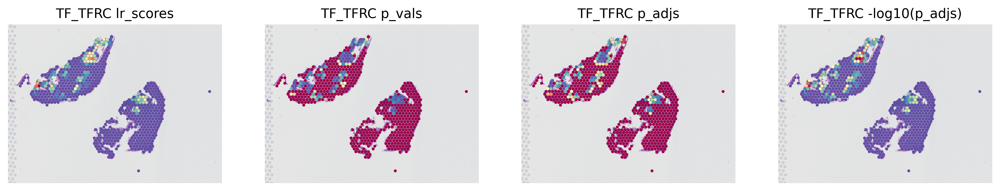

In [39]:
best_lr = new_data_adj.uns['lr_summary'].index.values[2]
stats = ['lr_scores', 'p_vals', 'p_adjs', '-log10(p_adjs)']
fig, axes = plt.subplots(ncols=len(stats), figsize=(16,6))
for i, stat in enumerate(stats):
    st.pl.lr_result_plot(new_data_adj, use_result=stat, use_lr=best_lr, show_color_bar=False, ax=axes[i])
    axes[i].set_title(f'{best_lr} {stat}')

C:\Users\s4435234\Anaconda3\lib\site-packages\stlearn\plotting\cci_plot.py:764: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[f"{lr}_binary_labels"] = lr_binary_labels


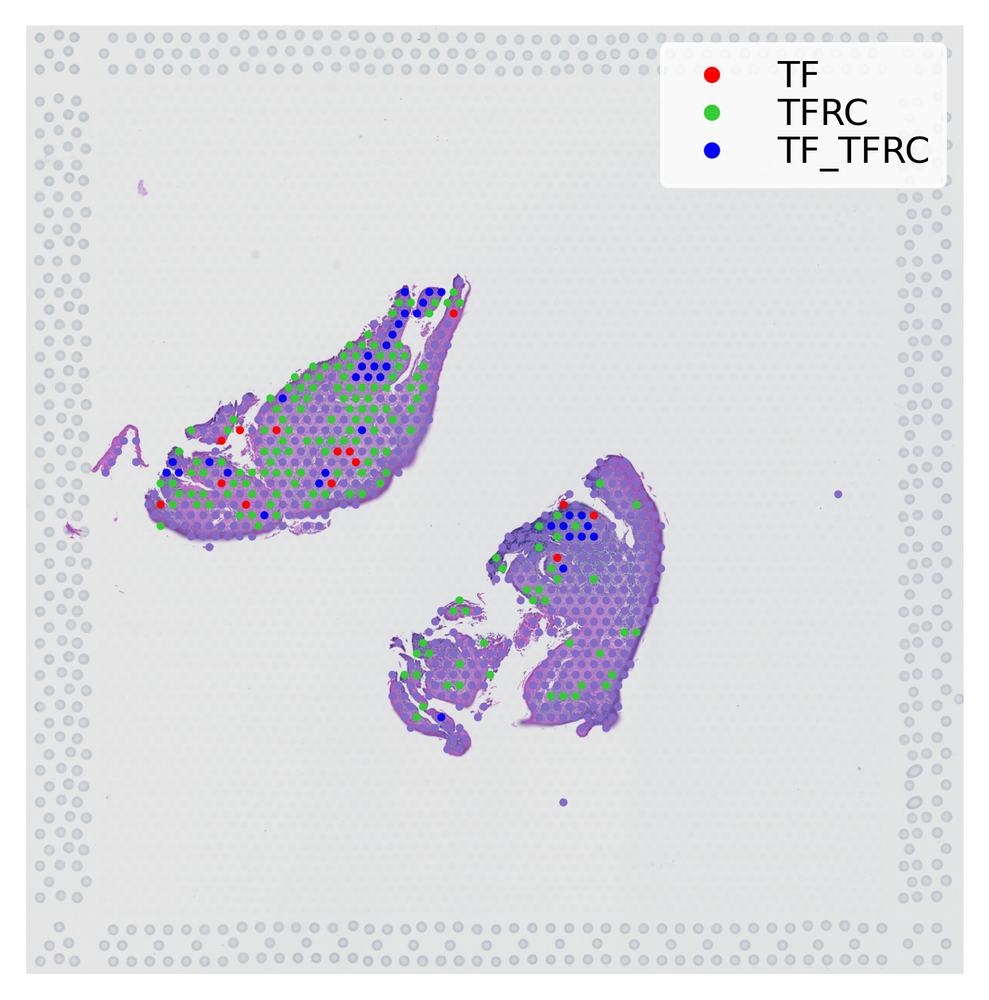

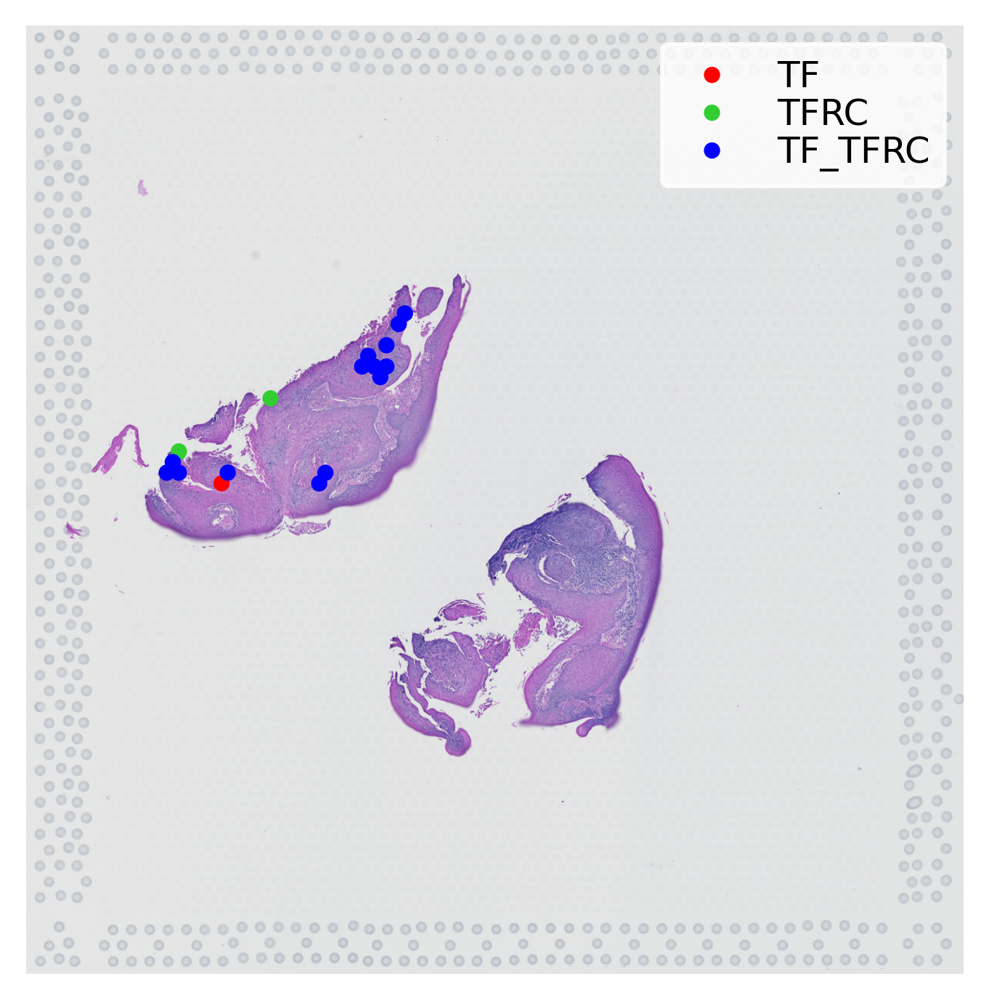

In [40]:
st.pl.lr_plot(new_data_adj, best_lr, inner_size_prop=0.1, outer_mode='binary', pt_scale=5,
              use_label=None, show_image=True,
              sig_spots=False)
st.pl.lr_plot(new_data_adj, best_lr, outer_size_prop=1, outer_mode='binary', pt_scale=20,
              use_label=None, show_image=True,
              sig_spots=True) 

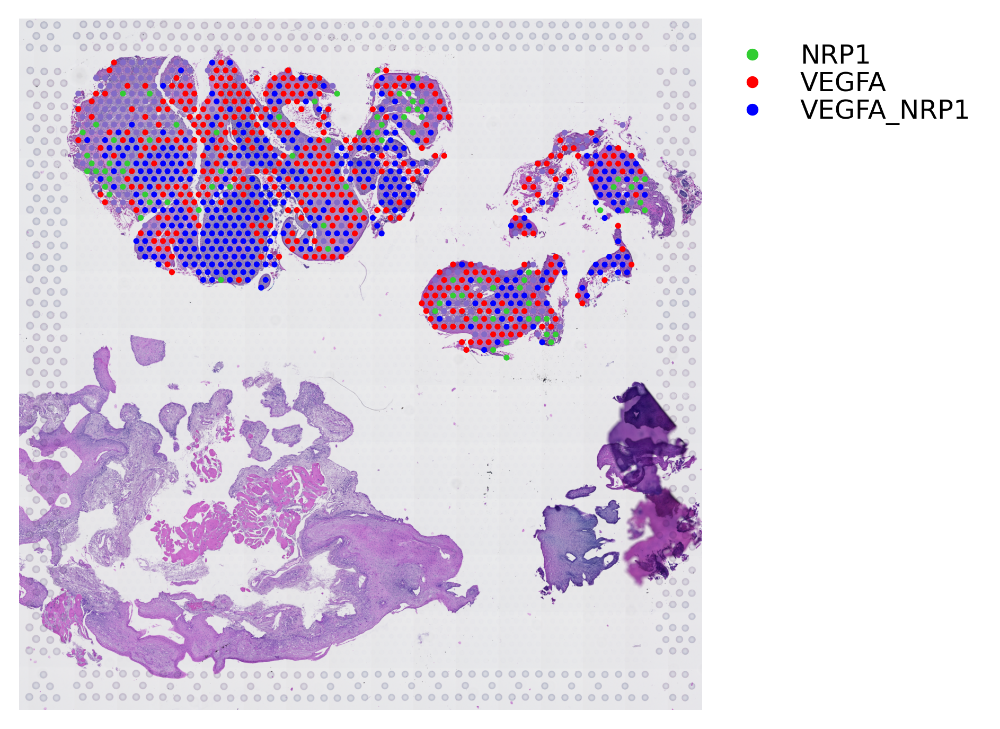

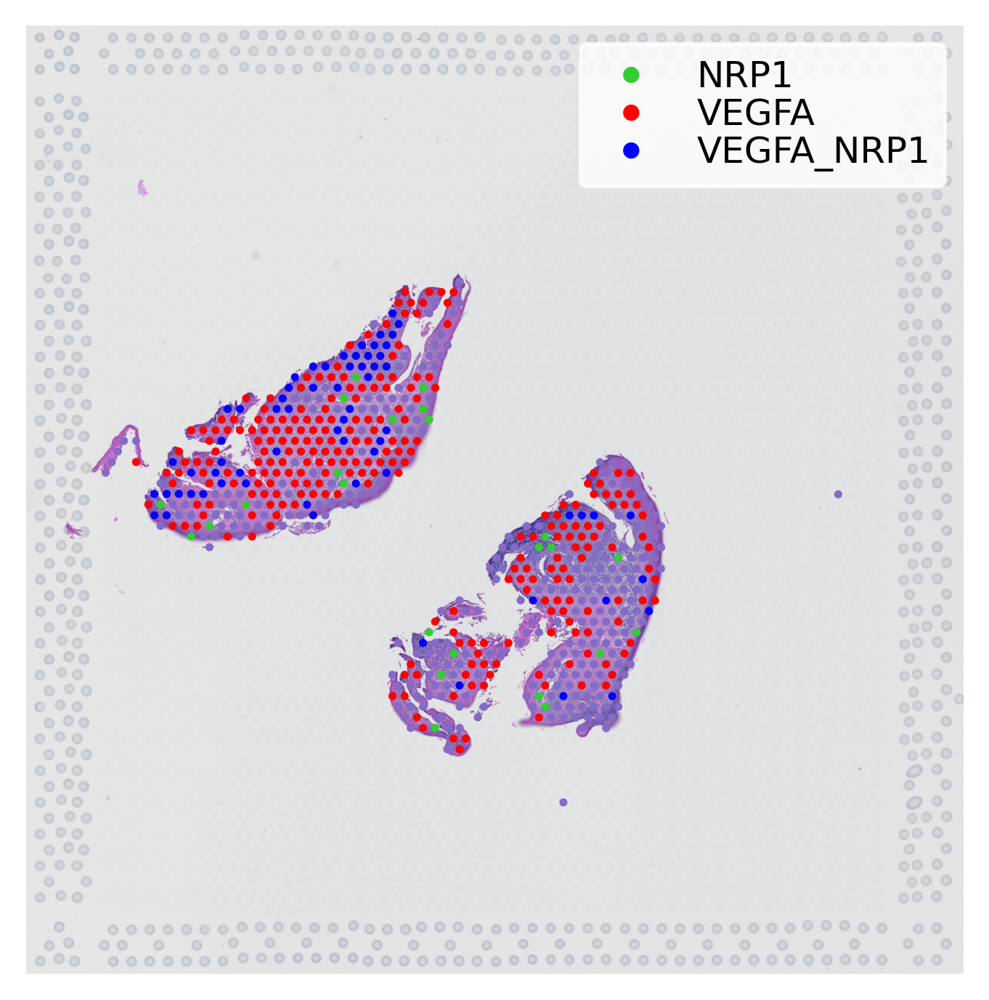

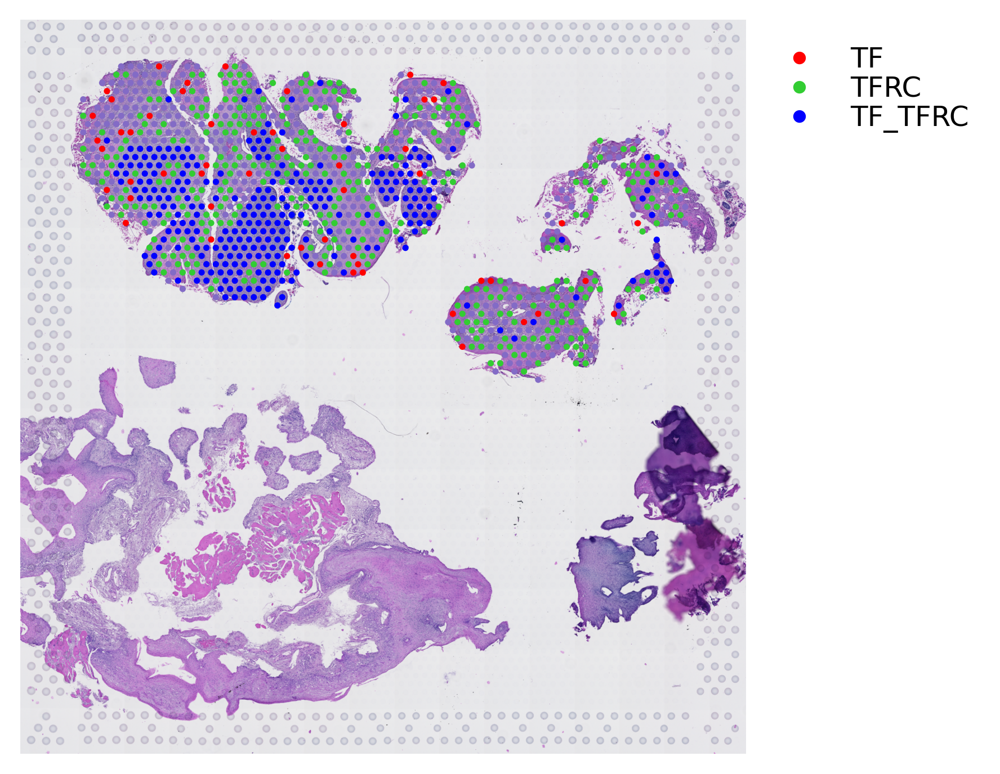

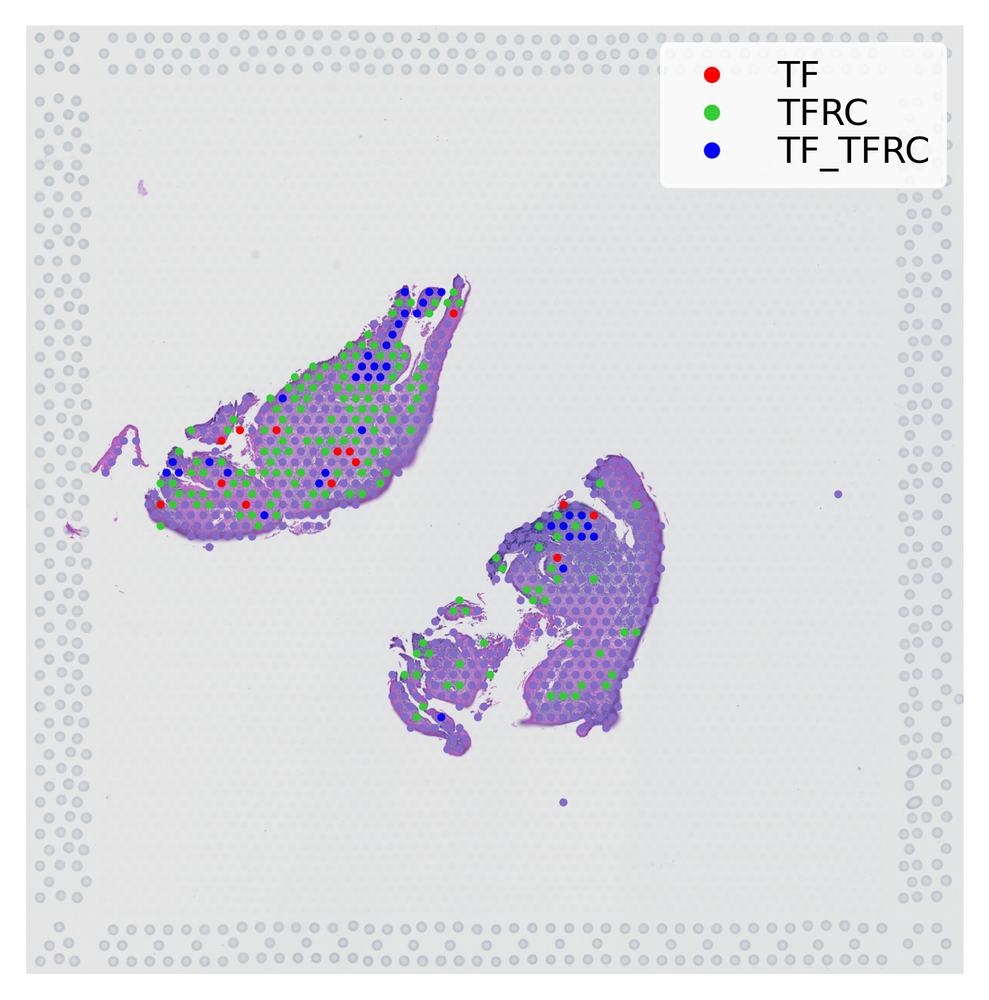

In [41]:
st.pl.lr_plot(old_tumour_adj, "VEGFA_NRP1", inner_size_prop=0.1, outer_mode='binary', pt_scale=5,
              use_label=None, show_image=True,
              sig_spots=False)
st.pl.lr_plot(new_data_adj, "VEGFA_NRP1", inner_size_prop=0.1, outer_mode='binary', pt_scale=5,
              use_label=None, show_image=True,
              sig_spots=False)
st.pl.lr_plot(old_tumour_adj, "TF_TFRC", inner_size_prop=0.1, outer_mode='binary', pt_scale=5,
              use_label=None, show_image=True,
              sig_spots=False)
st.pl.lr_plot(new_data_adj, "TF_TFRC", inner_size_prop=0.1, outer_mode='binary', pt_scale=5,
              use_label=None, show_image=True,
              sig_spots=False)

# Export Data for Downstream analysis and pathway analysis

In [42]:
#Exports data of all spots which expressed co-expression of LR pairs Vegfa and TF

old_tumour_adj.obs['VEGFA_NRP1_binary_labels'].to_csv("I:/SPOPSCC-Q4358/stlearn/VEGFA_NRP1_Spots_old.csv", sep=',')
new_data_adj.obs['VEGFA_NRP1_binary_labels'].to_csv("I:/SPOPSCC-Q4358/stlearn/VEGFA_NRP1_Spots_new.csv", sep=',')
old_tumour_adj.obs['TF_TFRC_binary_labels'].to_csv("I:/SPOPSCC-Q4358/stlearn/TF_TFRC_Spots_old.csv", sep=',')
new_data_adj.obs['TF_TFRC_binary_labels'].to_csv("I:/SPOPSCC-Q4358/stlearn/TF_TFRC_Spots_new.csv", sep=',')



In [43]:
#Code below subsets each dataset based on significant spots only
ddd = old_tumour_adj.obsm['lr_sig_scores']
d = pd.DataFrame(ddd)[2]

sig_veg = []
for i in d:
    if int(i) > 0:
        val = True
    else:
        val = False
    sig_veg.append(val)

old_tumour_adj.obs["sig_veg"] = sig_veg
old_tumour_adj.obs["sig_veg"] = old_tumour_adj.obs["sig_veg"].astype('category')

In [44]:
ddd = new_data_adj.obsm['lr_sig_scores']
d = pd.DataFrame(ddd)[0]

sig_veg = []
for i in d:
    if int(i) > 0:
        val = True
    else:
        val = False
    sig_veg.append(val)

new_data_adj.obs["sig_veg"] = sig_veg
new_data_adj.obs["sig_veg"] = new_data_adj.obs["sig_veg"].astype('category')

In [45]:
ddd = old_tumour_adj.obsm['lr_sig_scores']
d = pd.DataFrame(ddd)[0]

sig_veg = []
for i in d:
    if int(i) > 0:
        val = True
    else:
        val = False
    sig_veg.append(val)

old_tumour_adj.obs["sig_tf"] = sig_veg
old_tumour_adj.obs["sig_tf"] = old_tumour_adj.obs["sig_tf"].astype('category')

In [46]:
ddd = new_data_adj.obsm['lr_sig_scores']
d = pd.DataFrame(ddd)[2]

sig_veg = []
for i in d:
    if int(i) > 0:
        val = True
    else:
        val = False
    sig_veg.append(val)

new_data_adj.obs["sig_tf"] = sig_veg
new_data_adj.obs["sig_tf"] = new_data_adj.obs["sig_tf"].astype('category')

In [47]:
#exprots df which identify significant spots only
old_tumour_adj.obs['sig_veg'].to_csv("I:/SPOPSCC-Q4358/stlearn/VEGFA_NRP1_Spots_old_sig.csv", sep=',')
new_data_adj.obs['sig_veg'].to_csv("I:/SPOPSCC-Q4358/stlearn/VEGFA_NRP1_Spots_new_sig.csv", sep=',')
old_tumour_adj.obs['sig_tf'].to_csv("I:/SPOPSCC-Q4358/stlearn/TF_TFRC_Spots_old_sig.csv", sep=',')
new_data_adj.obs['sig_tf'].to_csv("I:/SPOPSCC-Q4358/stlearn/TF_TFRC_Spots_new_sig.csv", sep=',')

# Data further analysed in Rstudio